# Data Story Notebook

## EfficientNetworking: How To Make Friends Across Time and Space

In [193]:
%matplotlib inline
%load_ext autoreload
%reload_ext autoreload
%autoreload 2
%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/data"

import numpy as np
import pandas as pd
import seaborn as sns
import cufflinks as cf
import geopandas as gpd
import scipy.stats as stats
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.figure_factory as ff
from tqdm import tqdm
from igraph import Graph
from geopy.distance import distance
from poisson_etest import poisson_etest
from sklearn.linear_model import LinearRegression
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from functions import load_data, discretize_checkins, get_home_locations, get_countries

cf.go_offline()
pd.options.display.max_columns = 10
pd.options.display.max_rows = 10
init_notebook_mode(connected=True)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/data


Since we are interested in how they way and fashion in which people have friendships across time and space, let us start by looking our data in respect to these two properties.

### Introduction

We start off by simply vizualizing each home location on a world map.
In order to do this, we have to calculate each user's home location and the country he lives in.

#### Load Data

In [33]:
#B_checkins, B_edges = load_data("Brightkite")
#G_checkins, G_edges = load_data("Gowalla")

Compute the home locations of all users

In [34]:
# preprocess the data
# should be in load data fct from next on
#B_checkins = B_checkins[(B_checkins.latitude < 90) & (B_checkins.latitude > -90)]
#G_checkins = G_checkins[(G_checkins.latitude < 90) & (G_checkins.latitude > -90)]
#B_checkins = B_checkins.loc[~((B_checkins['latitude'] == 0) & (B_checkins['longitude'] == 0))]

In [35]:
#B_checkins = discretize_checkins(B_checkins)
#G_checkins = discretize_checkins(G_checkins)

In [36]:
#B_homes = get_home_locations(B_checkins)
#G_homes = get_home_locations(G_checkins)

In [37]:
#B_countries = get_countries(B_homes)
#B_homes["country"] = B_countries
#G_countries = get_countries(G_homes)
#G_homes["country"] = G_countries

In [38]:
# Save home locations
#B_homes.to_pickle("B_homes.pickle")
#G_homes.to_pickle("G_homes.pickle")

In [194]:
B_homes = pd.read_pickle("B_homes.pickle")
G_homes = pd.read_pickle("G_homes.pickle")

B_homes.columns = B_homes.columns.droplevel(1)
G_homes.columns = G_homes.columns.droplevel(1)

# Introduce a unique index per user
B_homes['user'] = B_homes.index
G_homes['user'] = G_homes.index

homes = B_homes.append(G_homes)

For the plot it is prettier to display the full country name, and not the iso2, therefore we add the full country name to the homes dataframe.

In [3]:
# Add full country name for plotting
cities = pd.read_csv("city_and_area.csv").drop(columns = ['Unnamed: 0'], axis = 1)

country_dict = cities[['country', 'iso2']].set_index('iso2').drop_duplicates().to_dict(orient='index')
# Some countries where missing in the cities data set
country_dict['PS'] = {'country':'Palestinian Territory'}
country_dict['CX'] = {'country':'Christmas Island'}
country_dict['NA'] = {'country':'Namibia'}
country_dict['VI'] = {'country':'Virgin Islands'}
country_dict['SX'] = {'country':'Sint Maarten'}
country_dict['GG'] = {'country':'Guernsey'}
country_dict['AX'] = {'country':'Åland Islands'}
country_dict['MF'] = {'country':'Saint Martin'}

#homes.head()
homes['country'] = homes['country'].map(lambda x: country_dict[x]['country'])
homes.head(5)

,longitude,latitude,country,user
user_id,,,,
0,-105.009140,39.756108,United States,0
1,-122.353819,37.581821,United States,1
2,-105.041977,39.771737,United States,2
3,-122.424280,37.765768,United States,3
4,24.937299,60.173985,Finland,4


We can now create our first plot with all the users in the world, using the interactiv `plotly` library.

In [42]:
%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/"
px.set_mapbox_access_token(open("mapbox_token").read())
fig = px.scatter_mapbox(homes,
                        lat=homes.latitude,
                        lon=homes.longitude,
                        hover_name="country",
                        zoom=1)

fig.update_traces(marker_color='peru', selector=dict(type='scattermapbox'))
fig.update_traces(marker_opacity=0.9, selector=dict(type='scattermapbox'))
fig.update_traces(marker_size=2, selector=dict(type='scattermapbox'))

fig.show();


html = plot(fig, auto_open=False, output_type='div')
with open("./plots/world_checkins.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_


## Research question 1

### Does user live in rural or urban area?

#### Load edges

In [4]:
%cd "/home/mogan/Desktop"
_, B_edges = load_data("Brightkite")
_, G_edges = load_data("Gowalla")

/home/mogan/Desktop


#### Load cities

In [5]:
cities = cities.drop(columns = ['capital', 'admin_name','city_ascii', 'iso3', 'id'], axis = 1)
cities.head()

,city,lat,lng,country,iso2,population,area
0,Tokyo,35.6897,139.6922,Japan,JP,37977000.0,2194.07
1,Jakarta,-6.2146,106.8451,Indonesia,ID,34540000.0,7062.50
2,Delhi,28.6600,77.2300,India,IN,29617000.0,1484.00
3,Mumbai,18.9667,72.8333,India,IN,23355000.0,4355.00
4,Manila,14.5958,120.9772,Philippines,PH,23088000.0,1474.82


### Deal with the cities

0. Estimate missing areas of cities with a Linear Model
1. Calculate population density
2. Drop cities with # inhabitants < 50.000 and population density < 1500 ([How we define cities](https://blogs.worldbank.org/sustainablecities/how-do-we-define-cities-towns-and-rural-areas))
       The Degree of Urbanization identifies cities as cities, if they have a population of at least 50,000 inhabitants in contiguous dense grid cells (>1,500 inhabitants per km2);
3. Calculate the radius for each city


In [6]:
# 0. Estimate the missing areas for cities
n_cities = cities[cities['area'].isna()]
n_cities = n_cities[n_cities['population'] > 50000]

# Can not predict for unknown population
n_cities = n_cities[~n_cities['population'].isnull()]

# Drop missing values for prediction
cities = cities[cities['population'] > 50000]
cities = cities[~cities['area'].isnull()]

In [7]:
# 1. Construct a linear model to estimate the missing areas
X = cities['population'].values.reshape(-1, 1)
y = cities['area'].values
reg = LinearRegression().fit(X, y)

# Predict the missing areas
pred_area = reg.predict(n_cities['population'].values.reshape(-1, 1))
n_cities['area'] = pred_area

# Merge city data
cities = cities.append(n_cities)

# 2. Calculate population density again for all data
cities['density'] = cities['population'] / cities['area']

In [560]:
# 3. Calculate the radius for each city
def radius(A):
    return np.sqrt(A/np.pi)

cities['radius'] = cities['area'].apply(lambda x: radius(x))

Plot all the cities on the world map

In [235]:
%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/"
cities_ = cities[(cities['population'] > 50000) & (cities['density'] > 1500)]


px.set_mapbox_access_token(open("mapbox_token").read())
fig = px.scatter_mapbox(cities_,
                        lat=cities_.lat,
                        lon=cities_.lng,
                        hover_name="city",
                        zoom=1)

fig.update_traces(marker_color='seagreen', selector=dict(type='scattermapbox'))
fig.update_traces(marker_size=3, selector=dict(type='scattermapbox'))

fig.show();


html = plot(fig, auto_open=False, output_type='div')
with open("./plots/world_cities.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_


### RQ 1: Analysis for non-US citizens

In [9]:
cities_non_US = cities[cities['iso2']!= 'US']

# 4. Drop cities with # inhabitants < 50.000 and population density < 1500
cities_non_US = cities_non_US[(cities_non_US['population'] > 50000) & (cities_non_US['density'] > 1500)]
#cities_non_US = cities_non_US[(cities_non_US['population'] > 50000)]

cities_non_US = cities_non_US.drop_duplicates()

In [49]:
# Save cities dataframe
#cities_non_US.to_pickle("cities_non_US.pickle")

In [10]:
cities_non_US.head()

,city,lat,lng,country,iso2,population,area,density,radius
0,Tokyo,35.6897,139.6922,Japan,JP,37977000.0,2194.07,17308.928156,26.427148
1,Jakarta,-6.2146,106.8451,Indonesia,ID,34540000.0,7062.50,4890.619469,47.413749
2,Delhi,28.6600,77.2300,India,IN,29617000.0,1484.00,19957.547170,21.734118
3,Mumbai,18.9667,72.8333,India,IN,23355000.0,4355.00,5362.801378,37.232238
4,Manila,14.5958,120.9772,Philippines,PH,23088000.0,1474.82,15654.791771,21.666790


In [11]:
# How many cities are left?
cities_non_US.shape

(1256, 9)

In [13]:
# Extract Non Us citizens
B_homes_non_US = B_homes[(B_homes['country'] != 'US')]
G_homes_non_US = G_homes[(G_homes['country'] != 'US')]

# Create a huge dataframe with all cities per country to then check if a home location is close to a city
B_merge_non_US = B_homes_non_US.merge(cities_non_US, left_on = 'country', right_on = 'iso2')
G_merge_non_US = G_homes_non_US.merge(cities_non_US, left_on = 'country', right_on = 'iso2')

In [14]:
B_merge_non_US['distance_to_city'] = B_merge_non_US.apply(lambda row: distance((row['latitude'], row['longitude']), (row['lat'],row['lng']) ).km, axis = 1)
G_merge_non_US['distance_to_city'] = G_merge_non_US.apply(lambda row: distance((row['latitude'], row['longitude']), (row['lat'],row['lng']) ).km, axis = 1)

In [15]:
B_lives_urban = B_merge_non_US.groupby("user").apply(lambda x: (x['distance_to_city'] < x['radius']).any()).to_frame()
B_lives_urban = B_lives_urban.rename(columns = {0:'lives_urban'})

G_lives_urban = G_merge_non_US.groupby("user").apply(lambda x: (x['distance_to_city'] < x['radius']).any()).to_frame()
G_lives_urban = G_lives_urban.rename(columns = {0:'lives_urban'})

In [16]:
# Integrate the 'lives_urban' variable into the home location datasets
B_homes_non_US = B_homes_non_US.merge(B_lives_urban, left_on = 'user', right_index = True)
G_homes_non_US = G_homes_non_US.merge(G_lives_urban, left_on = 'user', right_index = True)

Calculate the number of friends per user, group by rural/city and compare amount of friends between the groups


In [17]:
B_friends = B_edges.groupby('from_id').count()
G_friends = G_edges.groupby('from_id').count()

In [18]:
B_homes_non_US = B_homes_non_US.merge(B_friends, left_on = 'user', right_index = True).rename(columns = {'to_id':'#_friends'})
G_homes_non_US = G_homes_non_US.merge(G_friends, left_on = 'user', right_index = True).rename(columns = {'to_id':'#_friends'})

Compare the amount of friends for urban/ rural users seperately for the two data sets and then for all the data together

In [20]:
B_homes_non_US.groupby('lives_urban')['#_friends'].describe()

,count,mean,std,min,25%,50%,75%,max
lives_urban,,,,,,,,
False,10262.0,7.268271,17.932576,1.0,1.0,2.0,6.0,732.0
True,8517.0,8.936245,22.933534,1.0,1.0,3.0,7.0,550.0


In [21]:
G_homes_non_US.groupby('lives_urban')['#_friends'].describe()

,count,mean,std,min,25%,50%,75%,max
lives_urban,,,,,,,,
False,32465.0,10.750408,23.368752,1.0,2.0,5.0,11.0,1066.0
True,19148.0,11.575987,30.457469,1.0,2.0,4.0,10.0,1458.0


In [23]:
join_homes = B_homes_non_US.append(G_homes_non_US)
table_homes = join_homes.groupby('lives_urban')['#_friends'].describe()
table_homes

,count,mean,std,min,25%,50%,75%,max
lives_urban,,,,,,,,
False,42727.0,9.914082,22.234612,1.0,2.0,4.0,10.0,1066.0
True,27665.0,10.763311,28.380406,1.0,2.0,4.0,9.0,1458.0


Create a plot for the data story

In [24]:
%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/"
fig = go.Figure(data=[go.Table(
    header=dict(values=['Lives', 'Count', 'Mean', 'Std', 'min', '25%', '50%', '75%', 'max'],
                line_color='darkslategray',
                fill_color='peru',
                align='left'),
    cells=dict(values=[['Rural', 'Urban'],
                       [table_homes.iloc[0][0], table_homes.iloc[1][0]], [np.round(table_homes.iloc[0][1],3), np.round(table_homes.iloc[1][1],3)],
                       [np.round(table_homes.iloc[0][2],3), np.round(table_homes.iloc[1][2],3)], [table_homes.iloc[0][3], table_homes.iloc[1][3]], # 1st column
                       [table_homes.iloc[0][4], table_homes.iloc[1][4]], [table_homes.iloc[0][5], table_homes.iloc[1][5]],
                       [table_homes.iloc[0][6], table_homes.iloc[1][6]], [table_homes.iloc[0][7], table_homes.iloc[1][7]]], # 2nd column
               line_color='darkslategray',
               fill_color='seashell',
               align='left'))
])

#fig.update_layout(width=500, height=300)
fig.show()


html = plot(fig, auto_open=False, output_type='div')
with open("./plots/urban_rural_friends_non_US.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_


Check the plotted distributions for both data sets

/home/mogan/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

/home/mogan/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).



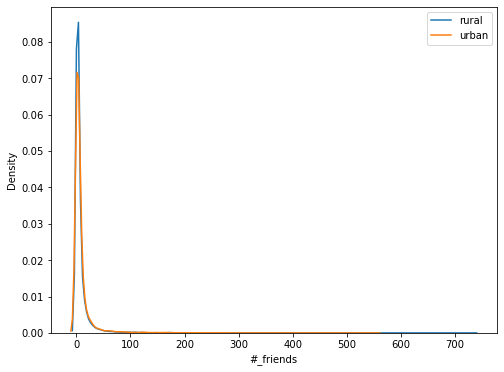

In [62]:
B_urban = B_homes[B_homes['lives_urban'] == True]
B_rural = B_homes[B_homes['lives_urban'] == False]

plt.figure(figsize=(8,6))
sns.distplot(B_rural['#_friends'], label='rural', hist=False)
sns.distplot(B_urban['#_friends'], label='urban', hist=False)
plt.legend();

/home/mogan/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

/home/mogan/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).



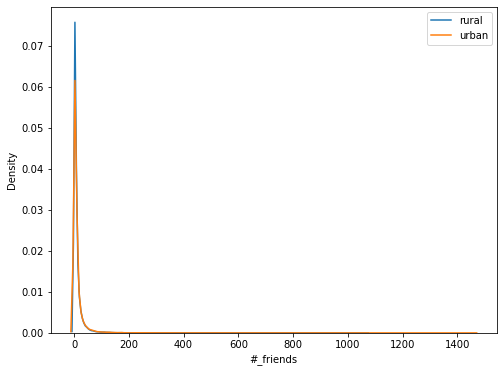

In [63]:
G_urban = G_homes[G_homes['lives_urban'] == True]
G_rural = G_homes[G_homes['lives_urban'] == False]

plt.figure(figsize=(8,6))
#sns.displot(data = G_homes, x = '#_friends', hue='lives_urban', kind="hist", bins = 30)
sns.distplot(G_rural['#_friends'], label='rural', hist=False)
sns.distplot(G_urban['#_friends'], label='urban', hist=False)
plt.legend();

#sns.displot(G_urban['#_friends'], label='urban', kind="hist")
#plt.legend();

In [28]:
# Group data together
hist_data = [join_homes['#_friends'][join_homes['lives_urban'] == True].values, 
             join_homes['#_friends'][join_homes['lives_urban'] == False].values]

group_labels = ['Urban', 'Rural']
colors = ['seagreen', 'peru']


# Create distplot with custom bin_size
fig = ff.create_distplot(hist_data, group_labels, bin_size=1, colors=colors)
fig.update_layout(plot_bgcolor='seashell')
fig.update_layout(
    title="Distribution of friends of Non-US citizens",
    xaxis_title="Number of friends",
    yaxis_title="Density",
    legend_title="User lives"
    )
fig.update_layout(barmode='stack')

fig.show()

%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots"

html = plot(fig, auto_open=False, output_type='div')
with open("urban_rural_friends_non_US_distribution.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots


### RQ 1: Analysis for US citizens

In [91]:
B_homes_US = B_homes[(B_homes['country'] == 'US')]
G_homes_US = G_homes[(G_homes['country'] == 'US')]

n = 4000
B_homes_US = B_homes_US.sample(n, random_state=3)
G_homes_US = G_homes_US.sample(n, random_state=3)

cities_US = cities[cities['iso2'] == 'US']
cities_US = cities_US[(cities_US['population'] > 50000) & (cities_US['density'] > 1500)]
cities_US['radius'] = cities_US['radius'] * 2

We had the impression that some US cities are missing in the cities data set, so we crawled another data set from Wikipedia which contains all US cities with more than $100000$ inhabitants. We will merge it with the existing US cities to obtain all cities between $50000$ and $100000$ citizens.

In [561]:
# Wrangle US cities to fit to other cities
%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/data"
us_cities = pd.read_csv("./us_cities.csv")
us_cities = us_cities.drop(columns=['2019rank', 'State[c]', '2010Census', 'Change', '2016 land area','2016 population density'])
us_cities = us_cities.rename(columns={'City':'city', '2019estimate':'population', '2016 land area.1':'area','2016 population density.1':'density' })
us_cities['population'] = us_cities['population'].str.replace(',','.')#.astype('float64')
us_cities['population'] = us_cities['population'].str.replace(r'\.', '').astype(float)
us_cities['city'] = us_cities['city'].str.replace(r'\[\w+\]', '')
us_cities['area'] = us_cities['area'].str.replace(r'\s\D+\d', '')
us_cities['area'] = us_cities['area'].str.replace(',','').astype(float)
us_cities['density'] = us_cities['density'].str.replace(r'/\D+\d', '')
us_cities['density'] = us_cities['density'].str.replace(',','').astype(float)
us_cities['Location'] = us_cities['Location'].str.split(r'/', expand = True)[1]
us_cities[['lat', 'lng']] = us_cities['Location'].str.split(r'\s', expand = True)[[1,2]]
us_cities = us_cities.drop(columns=['Location'], axis=1)
us_cities['lat'] = us_cities['lat'].str.replace('°N','').str.replace('\ufeff','').astype(float)
us_cities['lng'] = us_cities['lng'].str.replace('°W','').str.replace('\ufeff','').astype(float)
us_cities['lng'] = us_cities['lng'] * -1
us_cities['lng'][us_cities['lng'] > 0] = us_cities['lng'][us_cities['lng'] > 0] *-1
us_cities['iso2'] = 'US'
us_cities['country'] = 'United States'
us_cities['radius'] = us_cities['area'].apply(lambda x: radius(x))

us_cities = us_cities.append(cities_US)
us_cities = us_cities.drop_duplicates(subset=["city"], keep="first")
us_cities = us_cities[(us_cities['population'] > 50000) & (us_cities['density'] > 1500)]
#us_cities.to_pickle('us_cities.pickle')

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/data


After inspecting the two cities datasets we found that there is just one more city in the newly crawled dataset, so in the end the results are the same for both city datasets.

Let's visualize all the US cities to see whether we are on the right track:

In [576]:
%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/"
px.set_mapbox_access_token(open("mapbox_token").read())
fig = px.scatter_mapbox(cities_US,
                        lat=cities_US.lat,
                        lon=cities_US.lng,
                        hover_name="city",
                        zoom=1)

fig.update_traces(marker_color='black', selector=dict(type='scattermapbox'))
fig.update_traces(marker_opacity=0.9, selector=dict(type='scattermapbox'))
fig.update_traces(marker_size=3, selector=dict(type='scattermapbox'))

fig.show();



/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_


In [92]:
# Create a huge dataframe with all cities per country to then check if a home location is close to a city
B_merge_US = B_homes_US.merge(cities_US, left_on = 'country', right_on = 'iso2')
G_merge_US = G_homes_US.merge(cities_US, left_on = 'country', right_on = 'iso2')

In [93]:
B_merge_US['distance_to_city'] = B_merge_US.apply(lambda row: distance((row['latitude'], row['longitude']), (row['lat'],row['lng']) ).km, axis = 1)
G_merge_US['distance_to_city'] = G_merge_US.apply(lambda row: distance((row['latitude'], row['longitude']), (row['lat'],row['lng']) ).km, axis = 1)

In [94]:
B_lives_urban = B_merge_US.groupby("user").apply(lambda x: (x['distance_to_city'] < x['radius']).any()).to_frame()
B_lives_urban = B_lives_urban.rename(columns = {0:'lives_urban'})

G_lives_urban = G_merge_US.groupby("user").apply(lambda x: (x['distance_to_city'] < x['radius']).any()).to_frame()
G_lives_urban = G_lives_urban.rename(columns = {0:'lives_urban'})

In [95]:
# Integrate the 'lives_urban' variable into the home location datasets
B_homes_US = B_homes_US.merge(B_lives_urban, left_on = 'user', right_index = True)
G_homes_US = G_homes_US.merge(G_lives_urban, left_on = 'user', right_index = True)

Calculate the number of friends per user, group by rural/city and compare amount of friends between the groups


In [96]:
B_homes_US = B_homes_US.merge(B_friends, left_on = 'user', right_index = True).rename(columns = {'to_id':'#_friends'})
G_homes_US = G_homes_US.merge(G_friends, left_on = 'user', right_index = True).rename(columns = {'to_id':'#_friends'})

Compare the amount of friends for urban/ rural users seperately for the two data sets and then for all the data together

In [97]:
#B_homes.groupby('lives_urban')['#_friends'].describe()
# G_homes.groupby('lives_urban')['#_friends'].describe()
join_homes = B_homes_US.append(G_homes_US)
table_homes = join_homes.groupby('lives_urban')['#_friends'].describe()
table_homes

,count,mean,std,min,25%,50%,75%,max
lives_urban,,,,,,,,
False,4925.0,10.387005,25.377061,1.0,1.0,4.0,9.0,705.0
True,3075.0,9.590244,24.908667,1.0,1.0,3.0,9.0,752.0


Create a plot for the data story

In [98]:
%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/"
fig2 = go.Figure(data=[go.Table(
    header=dict(values=['Lives', 'Count', 'Mean', 'Std', 'min', '25%', '50%', '75%', 'max'],
                line_color='darkslategray',
                fill_color='peru',
                align='left'),
    cells=dict(values=[['Rural', 'Urban'],
                       [table_homes.iloc[0][0], table_homes.iloc[1][0]], [np.round(table_homes.iloc[0][1],3), np.round(table_homes.iloc[1][1],3)],
                       [np.round(table_homes.iloc[0][2],3), np.round(table_homes.iloc[1][2],3)], [table_homes.iloc[0][3], table_homes.iloc[1][3]], # 1st column
                       [table_homes.iloc[0][4], table_homes.iloc[1][4]], [table_homes.iloc[0][5], table_homes.iloc[1][5]],
                       [table_homes.iloc[0][6], table_homes.iloc[1][6]], [table_homes.iloc[0][7], table_homes.iloc[1][7]]], # 2nd column
               line_color='darkslategray',
               fill_color='seashell',
               align='left'))
])

fig2.show()


html2 = plot(fig2, auto_open=False, output_type='div')
with open("./plots/urban_rural_friends_US.html", 'w') as file:
    file.write(html2)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_


Check the plotted distributions for both data sets

In [99]:
import plotly.figure_factory as ff
import numpy as np
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot


# Group data together
hist_data = [join_homes['#_friends'][join_homes['lives_urban'] == True].values, 
             join_homes['#_friends'][join_homes['lives_urban'] == False].values]

group_labels = ['Urban', 'Rural']
colors = ['seagreen', 'peru']


# Create distplot with custom bin_size
fig = ff.create_distplot(hist_data, group_labels, bin_size=1, colors=colors)
fig.update_layout(plot_bgcolor='seashell')
fig.update_layout(
    title="Distribution of friends of US citizens",
    xaxis_title="Number of friends",
    yaxis_title="Density",
    legend_title="User lives"
    )
fig.update_layout(barmode='stack')

fig.show()

%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots"

html = plot(fig, auto_open=False, output_type='div')
with open("urban_rural_friends_US_distribution.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots


## Research question 2

#### 2. How often do users visit each other? Does it depend on whether they live in a city or not or on the season of the year?

Load data

In [ ]:
# Make a variable for city and plot colored by city
# Load cities
#us_cities = pd.read_pickle('us_cities.pickle')
#cities_non_US = pd.read_pickle('cities_non_US.pickle')

In [525]:
%cd "/home/mogan/Desktop"
bk_checkins, bk_edges = load_data("Brightkite")
gw_checkins, gw_edges = load_data("Gowalla")

bk_checkins = bk_checkins.drop(columns=['location_id'], axis=1)
gw_checkins = gw_checkins.drop(columns=['location_id'], axis=1)


/home/mogan/Desktop


#### How often visit Non-US-citizens each other?

In [526]:
# Extract Non Us citizens
B_homes_non_US = B_homes[(B_homes['country'] != 'US')]
G_homes_non_US = G_homes[(G_homes['country'] != 'US')]

In [527]:
B_homes_non_US = B_homes_non_US.rename(columns={'longitude':'home_longitude', 'latitude':'home_latitude'})#.drop(columns=['user'], axis=1)
G_homes_non_US = G_homes_non_US.rename(columns={'longitude':'home_longitude', 'latitude':'home_latitude'})#.drop(columns=['user'], axis=1)

bk_checkins = bk_checkins.merge(B_homes_non_US, left_on='user_id', right_index=True)
gw_checkins = gw_checkins.merge(G_homes_non_US, left_on='user_id', right_index=True)

In [528]:
# randomly sample users and take their checkins
n = 50 # number of users for analysis
bk_user = bk_checkins['user_id'].sample(n, random_state=1)
gw_user = gw_checkins['user_id'].sample(n, random_state=1)
bk_checkins = bk_checkins[bk_checkins['user_id'].isin(bk_user.values)]
gw_checkins = gw_checkins[gw_checkins['user_id'].isin(gw_user.values)]

In [529]:
bk_checkins = bk_checkins.rename(columns={'home_longitude':'home_longitude_A', 'home_latitude':'home_latitude_A'})
gw_checkins = gw_checkins.rename(columns={'home_longitude':'home_longitude_A', 'home_latitude':'home_latitude_A'})

In [530]:
# Make a unique index for every check in, because there is no other unique variable
bk_checkins['check-in'] = bk_checkins.index
gw_checkins['check-in'] = gw_checkins.index

In [531]:
# Merge check-in data with the friend network dataframe
bk_checkins_merged = bk_checkins.merge(bk_edges, left_on = 'user_id', right_on = 'from_id').drop(columns = ['from_id'], axis = 1)
gw_checkins_merged = gw_checkins.merge(gw_edges, left_on = 'user_id', right_on = 'from_id').drop(columns = ['from_id'], axis = 1)

In [532]:
# Add each friend's B home location to the extended dataframe
bk_checkins_merged = bk_checkins_merged.merge(B_homes_non_US, left_on='to_id', right_index=True)#.drop(columns=['home_longitude_y', 'home_latitude_y'], axis=1)
gw_checkins_merged = gw_checkins_merged.merge(G_homes_non_US, left_on='to_id', right_index=True)#.drop(columns=['home_longitude_y', 'home_latitude_y'], axis=1)

In [533]:
# Calculate the distance between check-ins and friends home
bk_checkins_merged['distances_to_friend'] = bk_checkins_merged.apply(lambda x: distance((x['latitude'], x['longitude']), (x['home_latitude'], x['home_longitude'])).km, axis = 1)
gw_checkins_merged['distances_to_friend'] = gw_checkins_merged.apply(lambda x: distance((x['latitude'], x['longitude']), (x['home_latitude'], x['home_longitude'])).km, axis = 1)

In [534]:
# Investigate if a check-in was a friends visit or not 
# by grouping by check-in id's and checking if any distance is smaller than r
radius = 25
bk_friend_visited = bk_checkins_merged.groupby("check-in").apply(lambda x: (x['distances_to_friend'] < radius).any()).to_frame()
gw_friend_visited = gw_checkins_merged.groupby("check-in").apply(lambda x: (x['distances_to_friend'] < radius).any()).to_frame()

How often do they visit each other?

In [535]:
bk_checkins_merged['visited_friend'] = bk_checkins_merged.apply(lambda x: (x['distances_to_friend'] < radius), axis = 1)
gw_checkins_merged['visited_friend'] = gw_checkins_merged.apply(lambda x: (x['distances_to_friend'] < radius), axis = 1)

In [536]:
bk_friend_visited = bk_checkins_merged[bk_checkins_merged['visited_friend'] == True].groupby(['user_id','to_id']).count().iloc[:,:1]
gw_friend_visited = gw_checkins_merged[gw_checkins_merged['visited_friend'] == True].groupby(['user_id','to_id']).count().iloc[:,:1]

In [537]:
bk_friend_visited['data'] = 'Brightkite'
gw_friend_visited['data'] = 'Gowalla'

bk_gw_friends = bk_friend_visited.append(gw_friend_visited)
#gw_friend_visited.head()

In [546]:
# Group data together
hist_data = [bk_gw_friends['checkin_time']]

group_labels = ['']
colors = ['seagreen']


# Create distplot with custom bin_size
fig = ff.create_distplot(hist_data, group_labels, bin_size=10, colors=colors)
fig.update_layout(plot_bgcolor='seashell')
fig.update_traces(opacity=1)
fig.update_layout(
    title="Distribution of friend visits of Non-US citizens",
    xaxis_title="Number of friend visits",
    yaxis_title="Density",
    legend_title=""
    )

fig.update_layout(barmode='stack')
fig.update_layout(showlegend=False)

fig.show()

%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots"

html = plot(fig, auto_open=False, output_type='div')
with open("Friend_visit_non_US_distribution.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots


Does it depend on whether they live in a city or not?

In [539]:
# Extract Non Us citizens
B_homes_non_US = B_homes[(B_homes['country'] != 'US')]
G_homes_non_US = G_homes[(G_homes['country'] != 'US')]

In [540]:
B_homes_non_US = B_homes_non_US[B_homes_non_US.index.isin(bk_checkins['user_id'])]
G_homes_non_US = G_homes_non_US[G_homes_non_US.index.isin(gw_checkins['user_id'])]

In [541]:
# Does user live in a city?
B_merge = B_homes_non_US.merge(cities_non_US, left_on = 'country', right_on = 'iso2')
B_merge['distance_to_city'] = B_merge.apply(lambda row: distance((row['latitude'], row['longitude']), (row['lat'],row['lng']) ).km, axis = 1)
B_lives_urban = B_merge.groupby("user").apply(lambda x: (x['distance_to_city'] < x['radius']).any()).to_frame()
B_lives_urban = B_lives_urban.rename(columns = {0:'lives_urban'})
B_homes_non_US = B_homes_non_US.merge(B_lives_urban, left_on = 'user', right_index = True)

In [542]:
# Does user live in a city?
G_merge = G_homes_non_US.merge(cities_non_US, left_on = 'country', right_on = 'iso2')
G_merge['distance_to_city'] = G_merge.apply(lambda row: distance((row['latitude'], row['longitude']), (row['lat'],row['lng']) ).km, axis = 1)
G_lives_urban = G_merge.groupby("user").apply(lambda x: (x['distance_to_city'] < x['radius']).any()).to_frame()
G_lives_urban = G_lives_urban.rename(columns = {0:'lives_urban'})
G_homes_non_US = G_homes_non_US.merge(G_lives_urban, left_on = 'user', right_index = True)

In [543]:
# merge homes and check_ins
bk_friend_city = bk_friend_visited.reset_index().merge(B_homes_non_US, left_on = 'user_id', right_index = True)
gw_friend_city = gw_friend_visited.reset_index().merge(G_homes_non_US, left_on = 'user_id', right_index = True)
bk_gw_friend_city = bk_friend_city.append(gw_friend_city)
bk_gw_friend_city.head()

,user_id,to_id,checkin_time,data,longitude,latitude,country,user,lives_urban
0,2894,191,33,Brightkite,138.396103,34.97276,JP,2894,False
1,2894,241,8,Brightkite,138.396103,34.97276,JP,2894,False
2,2894,250,81,Brightkite,138.396103,34.97276,JP,2894,False
3,2894,634,102,Brightkite,138.396103,34.97276,JP,2894,False
4,2894,637,91,Brightkite,138.396103,34.97276,JP,2894,False


In [545]:
# Group data together
hist_data = [bk_gw_friend_city['checkin_time'][bk_gw_friend_city['lives_urban'] == True].values, 
             bk_gw_friend_city['checkin_time'][bk_gw_friend_city['lives_urban'] == False].values]

group_labels = ['Urban', 'Rural']
colors = ['seagreen', 'peru']


# Create distplot with custom bin_size
fig = ff.create_distplot(hist_data, group_labels, bin_size=10, colors=colors)
fig.update_layout(plot_bgcolor='seashell')
fig.update_traces(opacity=1)
fig.update_layout(
    title="Distribution of friend visits of Non-US citizens",
    xaxis_title="Number of friend visits",
    yaxis_title="Density",
    legend_title="User lives"
    )

fig.update_layout(barmode='stack')

fig.show()

%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots"

html = plot(fig, auto_open=False, output_type='div')
with open("Friend_visit_non_US_urban.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots


Does it depend on the season of the year?

In [426]:
bk_checks = bk_checkins_merged[bk_checkins_merged['visited_friend'] == True]
# Convert to datetime and determine season of check-in
bk_checks['checkin_time'] = pd.to_datetime(bk_checks['checkin_time'], format='%Y-%m-%d')
bk_checks['month'] = pd.DatetimeIndex(bk_checks['checkin_time']).month 
bk_checks['year'] = pd.DatetimeIndex(bk_checks['checkin_time']).year 
bk_checks['season'] = bk_checks['month']%12 // 3 + 1
bk_checks['season'] = bk_checks['season'].map({1:'Winter', 2:'Spring', 3:'Summer', 4:'Automn'})

bk_friend_visits_season = bk_checks.groupby(['user_id','year','season']).count().iloc[:,0:1]
bk_friend_visits_season.head()

checkin_time
user_id year season              
2894    2009 Automn           509
             Spring          1048
             Summer           418
             Winter           211
        2010 Automn          1030

In [427]:
gw_checks = gw_checkins_merged[gw_checkins_merged['visited_friend'] == True]
# Convert to datetime and determine season of check-in
gw_checks['checkin_time'] = pd.to_datetime(gw_checks['checkin_time'], format='%Y-%m-%d')
gw_checks['month'] = pd.DatetimeIndex(gw_checks['checkin_time']).month 
gw_checks['year'] = pd.DatetimeIndex(gw_checks['checkin_time']).year 
gw_checks['season'] = gw_checks['month']%12 // 3 + 1
gw_checks['season'] = gw_checks['season'].map({1:'Winter', 2:'Spring', 3:'Summer', 4:'Automn'})

gw_friend_visits_season = gw_checks.groupby(['user_id','year','season']).count().iloc[:,0:1]
gw_friend_visits_season.head()

checkin_time
user_id year season              
1005    2010 Automn          1633
             Summer          1040
1384    2010 Automn           870
             Spring          2272
             Summer          2880

In [428]:
season_non_US = bk_friend_visits_season.append(gw_friend_visits_season)
season_non_US = season_non_US.reset_index()
season_non_US.head()


,user_id,year,season,checkin_time
0,2894,2009,Automn,509
1,2894,2009,Spring,1048
2,2894,2009,Summer,418
3,2894,2009,Winter,211
4,2894,2010,Automn,1030


In [472]:
season_non_US = season_non_US.sort_values(by=['year', 'season'])

#gw_checks[gw_checks['year']== 2008]['month'].sort_values()
#season_non_US[(season_non_US['season'] == 'Winter') & (season_non_US['year'] == 2010)]['checkin_time'] = season_non_US[(season_non_US['season'] == 'Winter') & (season_non_US['year'] == 2010)]['checkin_time'] * 3

In [491]:
gw_checks[gw_checks['year']== 209]['month'].sort_values()
# correct for missing months: 2008 starts in april
# 2010 ends in october
season_non_US= season_non_US[((season_non_US['season'] == 'Winter') & (season_non_US['year'] == 2010))]['checkin_time'].apply(lambda x: x*3)

In [523]:
import plotly.express as px

colors = ['seagreen', 'goldenrod', 'sienna', 'slategray']
group_labels = {'season':'Spring', 'summer':'Summer', 'automn':'Automn', 'winter':'Winter'}


fig = px.box(season_non_US, y="season", x='checkin_time', animation_frame="year", animation_group="season",
           hover_name="season", color='season', color_discrete_sequence=colors, points='all',
            category_orders={'season':['Spring','Summer','Automn','Winter']},
            hover_data={'season':False})#, category_orders= [1,2,3,4])#)
           #log_x=True, size_max=55, range_x=[100,100000], range_y=[25,90])

    
fig.update_layout(plot_bgcolor='seashell')
fig.update_layout(
    title="Distribution of friend visits of Non-US citizens per year and season",
    xaxis_title="Number of friend visits",
    yaxis_title="Season",
    legend_title="Season"
)

fig.update_layout(showlegend=False)


fig["layout"].pop("updatemenus") # optional, drop animation buttons
fig.update_xaxes(range=[0, 4000])
fig.show()

%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots"

html = plot(fig, auto_open=False, output_type='div')
with open("Friend_visit_non_US_season.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots


#### How often visit US-citizens each other?

In [363]:
# Make a variable for city and plot colored by city
# Load cities
#%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/data"

#us_cities = pd.read_pickle('us_cities.pickle')
#cities = pd.read_pickle('cities.pickle')

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/data


In [500]:
%cd "/home/mogan/Desktop"
bk_checkins, bk_edges = load_data("Brightkite")
gw_checkins, gw_edges = load_data("Gowalla")

/home/mogan/Desktop


In [501]:
# Extract US citizens
B_homes_US = B_homes[(B_homes['country'] == 'US')]
G_homes_US = G_homes[(G_homes['country'] == 'US')]

In [502]:
# randomly sample users and take their checkins
n = 100
bk_user = bk_checkins['user_id'].sample(n, random_state=1)
gw_user = gw_checkins['user_id'].sample(n, random_state=1)
bk_checkins = bk_checkins[bk_checkins['user_id'].isin(bk_user.values)]
gw_checkins = gw_checkins[gw_checkins['user_id'].isin(gw_user.values)]

In [503]:
bk_checkins = bk_checkins.rename(columns={'home_longitude':'home_longitude_A', 'home_latitude':'home_latitude_A'})
gw_checkins = gw_checkins.rename(columns={'home_longitude':'home_longitude_A', 'home_latitude':'home_latitude_A'})

In [504]:
# Make a unique index for every check in, because there is no other unique variable
bk_checkins['check-in'] = bk_checkins.index
gw_checkins['check-in'] = gw_checkins.index

In [505]:
# Merge check-in data with the friend network dataframe
bk_checkins_merged = bk_checkins.merge(bk_edges, left_on = 'user_id', right_on = 'from_id').drop(columns = ['from_id'], axis = 1)
gw_checkins_merged = gw_checkins.merge(gw_edges, left_on = 'user_id', right_on = 'from_id').drop(columns = ['from_id'], axis = 1)

In [506]:
# Add each friend's B home location to the extended dataframe
bk_checkins_merged = bk_checkins_merged.merge(B_homes_US, left_on='to_id', right_index=True)#.drop(columns=['home_longitude_y', 'home_latitude_y'], axis=1)
gw_checkins_merged = gw_checkins_merged.merge(G_homes_US, left_on='to_id', right_index=True)#.drop(columns=['home_longitude_y', 'home_latitude_y'], axis=1)

In [507]:
# Calculate the distance between check-ins and friends home
bk_checkins_merged['distances_to_friend'] = bk_checkins_merged.apply(lambda x: distance((x['latitude_x'], x['longitude_x']), (x['latitude_y'], x['longitude_y'])).km, axis = 1)
gw_checkins_merged['distances_to_friend'] = gw_checkins_merged.apply(lambda x: distance((x['latitude_x'], x['longitude_x']), (x['latitude_y'], x['longitude_y'])).km, axis = 1)

In [508]:
# Investigate if a check-in was a friends visit or not 
# by grouping by check-in id's and checking if any distance is smaller than r
radius = 25
bk_friend_visited = bk_checkins_merged.groupby("check-in").apply(lambda x: (x['distances_to_friend'] < radius).any()).to_frame()
gw_friend_visited = gw_checkins_merged.groupby("check-in").apply(lambda x: (x['distances_to_friend'] < radius).any()).to_frame()

In [509]:
bk_checkins_merged['visited_friend'] = bk_checkins_merged.apply(lambda x: (x['distances_to_friend'] < radius), axis = 1)
gw_checkins_merged['visited_friend'] = gw_checkins_merged.apply(lambda x: (x['distances_to_friend'] < radius), axis = 1)

How often do friends visit each other?

In [220]:
bk_friend_visited = bk_checkins_merged[bk_checkins_merged['visited_friend'] == True].groupby(['user_id','to_id']).count().iloc[:,:1]
gw_friend_visited = gw_checkins_merged[gw_checkins_merged['visited_friend'] == True].groupby(['user_id','to_id']).count().iloc[:,:1]

In [221]:
bk_friend_visited['data'] = 'Brightkite'
gw_friend_visited['data'] = 'Gowalla'

bk_gw_friends = bk_friend_visited.append(gw_friend_visited)

In [223]:
# Group data together
hist_data = [bk_gw_friends['checkin_time'].values]

group_labels = [''] #['Brightkite', 'Gowalla']
colors = ['seagreen'] #'seagreen', 

# Create distplot with custom bin_size
fig = ff.create_distplot(hist_data, group_labels, bin_size=10, colors=colors)
fig.update_layout(plot_bgcolor='seashell')
fig.update_traces(opacity=1)
fig.update_layout(
    title="Distribution of friend visits of US citizens",
    xaxis_title="Number of friend visits",
    yaxis_title="Density"
    )

fig.update_layout(barmode='stack')
fig.update_layout(showlegend=False)

fig.show()

%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots"

html = plot(fig, auto_open=False, output_type='div')
with open("Friend_visit_US_distribution.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots


In [224]:
# Reset extracting US citizens
B_homes_US = B_homes[(B_homes['country'] == 'US')]
G_homes_US = G_homes[(G_homes['country'] == 'US')]

In [225]:
B_homes_US = B_homes_US[B_homes_US.index.isin(bk_checkins['user_id'])]
G_homes_US = G_homes_US[G_homes_US.index.isin(gw_checkins['user_id'])]

In [226]:
B_merge.columns

Index(['longitude', 'latitude', 'country_x', 'user', 'city', 'lat', 'lng',
       'country_y', 'iso2', 'population', 'area', 'density', 'radius',
       'distance_to_city'],
      dtype='object')

In [227]:
# Does user live in a city?
B_merge = B_homes_US.merge(cities_US, left_on = 'country', right_on = 'iso2')
B_merge['distance_to_city'] = B_merge.apply(lambda row: distance((row['latitude'], row['longitude']), (row['lat'],row['lng']) ).km, axis = 1)
B_lives_urban = B_merge.groupby("user").apply(lambda x: (x['distance_to_city'] < x['radius']).any()).to_frame()
B_lives_urban = B_lives_urban.rename(columns = {0:'lives_urban'})
B_homes_US = B_homes_US.merge(B_lives_urban, left_on = 'user', right_index = True)

# Does user live in a city?
G_merge = G_homes_US.merge(cities_US, left_on = 'country', right_on = 'iso2')
G_merge['distance_to_city'] = G_merge.apply(lambda row: distance((row['latitude'], row['longitude']), (row['lat'],row['lng']) ).km, axis = 1)
G_lives_urban = G_merge.groupby("user").apply(lambda x: (x['distance_to_city'] < x['radius']).any()).to_frame()
G_lives_urban = G_lives_urban.rename(columns = {0:'lives_urban'})
G_homes_US = G_homes_US.merge(G_lives_urban, left_on = 'user', right_index = True)

In [228]:
# merge homes and check_ins
bk_friend_city = bk_friend_visited.reset_index().merge(B_homes_US, left_on = 'user_id', right_index = True)
gw_friend_city = gw_friend_visited.reset_index().merge(G_homes_US, left_on = 'user_id', right_index = True)
bk_gw_friend_city = bk_friend_city.append(gw_friend_city)
bk_gw_friend_city

,user_id,to_id,checkin_time,data,longitude,latitude,country,user,lives_urban
0,1,3,1099,Brightkite,-122.353819,37.581821,US,1,False
1,1,5,1099,Brightkite,-122.353819,37.581821,US,1,False
2,1,7,1117,Brightkite,-122.353819,37.581821,US,1,False
3,1,9,1117,Brightkite,-122.353819,37.581821,US,1,False
4,1,23,1117,Brightkite,-122.353819,37.581821,US,1,False
...,...,...,...,...,...,...,...,...,...
572,138674,184647,38,Gowalla,-122.423021,37.752940,US,138674,False
573,151464,60015,282,Gowalla,-81.594789,30.245666,US,151464,False
574,151464,105530,283,Gowalla,-81.594789,30.245666,US,151464,False
575,152688,62230,63,Gowalla,-97.159496,31.499811,US,152688,True


In [230]:
# Group data together
hist_data = [bk_gw_friend_city['checkin_time'][bk_gw_friend_city['lives_urban'] == True].values, 
             bk_gw_friend_city['checkin_time'][bk_gw_friend_city['lives_urban'] == False].values]

group_labels = ['Urban', 'Rural']
colors = ['seagreen', 'peru']


# Create distplot with custom bin_size
fig = ff.create_distplot(hist_data, group_labels, bin_size=10, colors=colors)
fig.update_layout(plot_bgcolor='seashell')
fig.update_traces(opacity=1)
fig.update_layout(
    title="Distribution of friend visits of US citizens",
    xaxis_title="Number of friend visits",
    yaxis_title="Density",
    legend_title="User lives"
    )

fig.update_layout(barmode='stack')

fig.show()

%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots"

html = plot(fig, auto_open=False, output_type='div')
with open("Friend_visit_US_urban.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots


Does it depend on the season of the year?

In [510]:
bk_checks = bk_checkins_merged[bk_checkins_merged['visited_friend'] == True]
# Convert to datetime and determine season of check-in
bk_checks['checkin_time'] = pd.to_datetime(bk_checks['checkin_time'], format='%Y-%m-%d')
bk_checks['month'] = pd.DatetimeIndex(bk_checks['checkin_time']).month 
bk_checks['year'] = pd.DatetimeIndex(bk_checks['checkin_time']).year 
bk_checks['season'] = bk_checks['month']%12 // 3 + 1
bk_checks['season'] = bk_checks['season'].map({1:'Winter', 2:'Spring', 3:'Summer', 4:'Automn'})

bk_friend_visits_season = bk_checks.groupby(['user_id','year','season']).count().iloc[:,0:1]
bk_friend_visits_season.head()

checkin_time
user_id year season              
1       2009 Automn          3453
             Spring          5908
             Summer          7736
             Winter           741
        2010 Automn           660

In [511]:
gw_checks = gw_checkins_merged[gw_checkins_merged['visited_friend'] == True]
# Convert to datetime and determine season of check-in
gw_checks['checkin_time'] = pd.to_datetime(gw_checks['checkin_time'], format='%Y-%m-%d')
gw_checks['month'] = pd.DatetimeIndex(gw_checks['checkin_time']).month 
gw_checks['year'] = pd.DatetimeIndex(gw_checks['checkin_time']).year 
gw_checks['season'] = gw_checks['month']%12 // 3 + 1
gw_checks['season'] = gw_checks['season'].map({1:'Winter', 2:'Spring', 3:'Summer', 4:'Automn'})

gw_friend_visits_season = gw_checks.groupby(['user_id','year','season']).count().iloc[:,0:1]
gw_friend_visits_season.head()

checkin_time
user_id year season              
217     2009 Automn           293
             Spring            57
             Winter          1161
        2010 Automn           146
             Spring          2028

In [512]:
season_US = bk_friend_visits_season.append(gw_friend_visits_season)
season_US = season_US.reset_index()
season_US.head()

,user_id,year,season,checkin_time
0,1,2009,Automn,3453
1,1,2009,Spring,5908
2,1,2009,Summer,7736
3,1,2009,Winter,741
4,1,2010,Automn,660


In [513]:
season_US = season_US.sort_values(by=['year', 'season'])
# correct for missing months: 2008 starts in april
# 2010 end ins october
#gw_checks[gw_checks['year']== 2008]['month'].sort_values()
#season_non_US[(season_non_US['season'] == 'Winter') & (season_non_US['year'] == 2010)]['checkin_time'] = season_non_US[(season_non_US['season'] == 'Winter') & (season_non_US['year'] == 2010)]['checkin_time'] * 3

In [524]:
import plotly.express as px

colors = ['seagreen', 'goldenrod', 'sienna', 'slategray']
group_labels = {'season':'Spring', 'summer':'Summer', 'automn':'Automn', 'winter':'Winter'}


fig = px.box(season_US, y="season", x='checkin_time', animation_frame="year", animation_group="season",
           hover_name="season", color='season', color_discrete_sequence=colors, points='all',
            category_orders={'season':['Spring','Summer','Automn','Winter']},
            hover_data={'season':False})#, category_orders= [1,2,3,4])#)
           #log_x=True, size_max=55, range_x=[100,100000], range_y=[25,90])

    
fig.update_layout(plot_bgcolor='seashell')
fig.update_layout(
    title="Distribution of friend visits of US citizens per year and season",
    xaxis_title="Number of friend visits",
    yaxis_title="Season",
    legend_title="Season"
)

fig.update_layout(showlegend=False)


fig["layout"].pop("updatemenus") # optional, drop animation buttons
fig.update_xaxes(range=[0, 6000])
fig.show()

%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots"
html = plot(fig, auto_open=False, output_type='div')
with open("Friend_visit_US_season.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots


## Research question 3:

Can we detect certain loosely connected sub-networks which corresponds to a circle of friends or a city?

Here we investigate the structure of the social graph through the use of a community detection algorithm. We restricted ourselves to US check-ins because our main interest was in the distribution of cities in the communities, so introducing country borders would make the analysis much more complicated.

In [2]:
B_homes = pd.read_pickle('data/B_homes.pickle')
B_homes.columns = [col[0] for col in B_homes.columns]
B_homes = B_homes[B_homes['country'] == 'US']

print(B_homes.shape[0])
B_homes.head(5)

30663


,longitude,latitude,country
user_id,,,
0,-105.009140,39.756108,US
1,-122.353819,37.581821,US
2,-105.041977,39.771737,US
3,-122.424280,37.765768,US
5,-122.421897,37.752990,US


In [3]:
G_homes = pd.read_pickle('data/G_homes.pickle')
G_homes.columns = [col[0] for col in G_homes.columns]
G_homes = G_homes[G_homes['country'] == 'US']

print(G_homes.shape[0])
G_homes.head(5)

50618


,longitude,latitude,country
user_id,,,
0,-97.756394,30.260821,US
2,-118.338449,34.067629,US
4,-122.436562,37.775379,US
5,-97.723548,30.283573,US
7,-97.752399,30.268355,US


We remove lone vertices since they will always just result in a cluster of size one, which is not very interesting.

In [4]:
def clean_data(name, homes):
    _, edges = load_data(name)

    x = edges['from_id']
    y = edges['to_id']

    friends = set(zip(x,y)).intersection(set(zip(y,x))) #remove non bidirectional edges
    friends = set(map(lambda x: (x[0], x[1]) if x[0] < x[1] else (x[1], x[0]), friends)) #remove duplicates
    edges = pd.DataFrame(friends)
    # remove users with no home
    in_homes = edges.apply(lambda x: True if x[0] in homes.index and x[1] in homes.index else False, axis=1) 
    edges = edges[in_homes]
    # remove homes with no friends
    homes = homes[np.logical_or(homes.index.isin(edges[0]), homes.index.isin(edges[1]))]
    return homes, edges


In [5]:
B_homes, B_edges = clean_data("Brightkite", B_homes)
G_homes, G_edges = clean_data("Gowalla", G_homes)
print("Brightkite edges", B_edges.shape[0])
print("Gowalla edges", G_edges.shape[0])

Brightkite edges 107124
Gowalla edges 216518


We use the igraph library to create the graph, since it has implementations for several community detection algorithms.

In [6]:
def make_graph(homes, edges):
    id_map = {}
    g = Graph()

    for i, row in tqdm(homes.iterrows(), total=homes.shape[0]):
        vertex = g.add_vertex(Name=i) # Name the vertices since we need the user_id later
        id_map[i] = vertex.index
    edges = edges.apply(lambda x: (id_map[x[0]], id_map[x[1]]), axis=1)
    g.add_edges(edges)

    g = g.as_undirected()

    return g

In [7]:
B_graph = make_graph(B_homes, B_edges)
G_graph = make_graph(G_homes, G_edges)

100%|██████████| 46198/46198 [00:02<00:00, 20724.64it/s]


We use the walktrap algorithm (https://arxiv.org/pdf/physics/0512106.pdf). It is quite efficient, usually runs in $O(n²log(n))$ time for n vertices.

In [8]:
B_community = B_graph.community_walktrap()
B_clust = B_community.as_clustering()

For both data sets, the top 10 clusters follow similar distributions

Text(0.5, 1.0, 'Brightkite top ten cluster sizes')

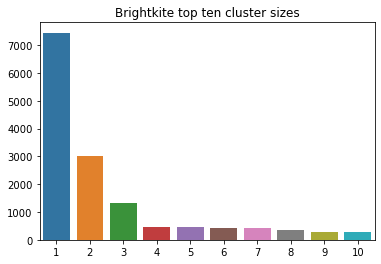

In [9]:
B_sizes = B_clust.sizes()
B_sorted_sizes = np.flip(np.sort(B_sizes))
B_arg_sizes = np.flip(np.argsort(B_sizes))
sns.barplot(np.arange(1,11), B_sorted_sizes[:10])
plt.title("Brightkite top ten cluster sizes")

In [11]:
G_community = G_graph.community_walktrap()
G_clust = G_community.as_clustering()

Text(0.5, 1.0, 'Gowalla top ten cluster sizes')

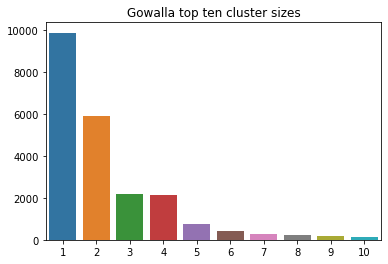

In [12]:
G_sizes = G_clust.sizes()
G_sorted_sizes = np.flip(np.sort(G_sizes))
G_arg_sizes = np.flip(np.argsort(G_sizes))
sns.barplot(np.arange(1,11), G_sorted_sizes[:10])
plt.title("Gowalla top ten cluster sizes")

In [13]:
# Gets the homes of the users in a cluster
def get_cluster_homes(cluster, homes):
    ids = []
    for v in cluster.vs:
        ids.append(v['Name'])
    return homes.loc[ids]

# Plots home locations on a map
def map_plot(data, name):
    px.set_mapbox_access_token(open("mapbox_token").read())
    fig = px.scatter_mapbox(data,
                            lat=data.latitude,
                            lon=data.longitude,
                            hover_name="country",
                            zoom=2)

    fig.update_traces(marker_color='peru', selector=dict(type='scattermapbox'))
    fig.update_traces(marker_opacity=0.9, selector=dict(type='scattermapbox'))
    fig.update_traces(marker_size=2, selector=dict(type='scattermapbox'))

    fig.show()


    html = plot(fig, auto_open=False, output_type='div')
    with open(f"./plots/{name}.html", 'w') as file:
        file.write(html)

In [14]:
tqdm.pandas()

# Gets the city counts in a dataframe with home locations
def get_city_counts(data):
    cities = pd.read_pickle('data/us_cities.pickle')
    data_merge = data.reset_index().merge(cities, left_on = 'country', right_on = 'iso2')
    data_merge['distance_to_city'] = data_merge.progress_apply(lambda row: distance((row['latitude'], row['longitude']),            (row['lat'],-row['lng']) ).km, axis = 1)
    data_lives_urban = data_merge.apply(lambda x: (x['distance_to_city'] < x['radius']), axis=1)
    return data_merge[data_lives_urban]['city'].value_counts()

In [15]:
n_samples = 5000

# Gets the homes and city counts from a cluster
def process_cluster(cluster, homes):
    homes = get_cluster_homes(cluster, homes)
    if homes.shape[0] > n_samples: # If cluster is too large, sample to get counts
        counts = get_city_counts(homes.sample(n_samples))
        counts /= n_samples
    else:
        counts = get_city_counts(homes)
        counts /= homes.shape[0]
    return homes, counts

Here we look at the top ten cities for the entire brightkite data set.

100%|██████████| 1585000/1585000 [05:05<00:00, 5186.66it/s]


Text(0.5, 1.0, 'Brightkite top 10 cities')

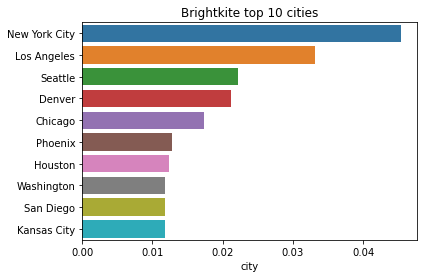

In [16]:
sample_homes = B_homes.sample(n_samples)
B_counts = get_city_counts(sample_homes)
B_counts /= n_samples
sns.barplot(B_counts[:10], B_counts.index[:10])
plt.title("Brightkite top 10 cities")

This is the largest cluster found in the brightkite data set. It contains about 25% of all users. As we can see it is quite spread out geographically, with no city clearly dominating. This might indicate that the users quite well connected across space. 

100%|██████████| 1585000/1585000 [05:07<00:00, 5148.99it/s]


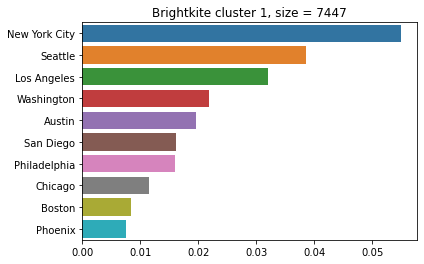

In [17]:
homes, counts = process_cluster(B_clust.subgraph(B_arg_sizes[0]), B_homes)
sns.barplot(counts[:10], counts.index[:10])
plt.title(f"Brightkite cluster 1, size = {homes.shape[0]}")
plt.xlabel("")
map_plot(homes, f"B{1}_us")

The second cluster found. Again quite spread out. The three largest cities in the cluster are all very far apart, one on the west coast, one in the midwest and one on the east coast.

100%|██████████| 953536/953536 [03:05<00:00, 5129.62it/s]


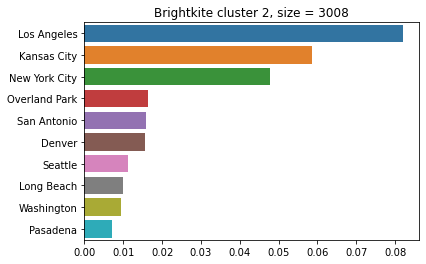

In [24]:
homes, counts = process_cluster(B_clust.subgraph(B_arg_sizes[1]), B_homes)
sns.barplot(counts[:10], counts.index[:10])
plt.title(f"Brightkite cluster 2, size = {homes.shape[0]}")
plt.xlabel("")
map_plot(homes, f"B{2}_us")

The third cluster is the first which is restricted geographically, it is dominated by two nearby cities, Denver and Boulder. It is perhaps a bit interesting that the first one of these restricted clusters was not dominated by New York or Los Angeles, which are the two largest cities in the overall data set.

100%|██████████| 420976/420976 [01:20<00:00, 5255.06it/s]


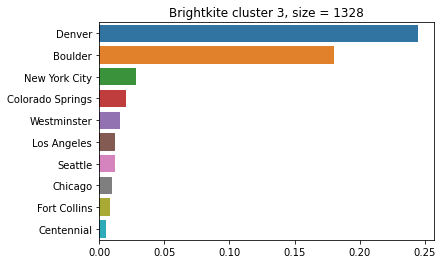

In [18]:
homes, counts = process_cluster(B_clust.subgraph(B_arg_sizes[2]), B_homes)
sns.barplot(counts[:10], counts.index[:10])
plt.title(f"Brightkite cluster 3, size = {homes.shape[0]}")
plt.xlabel("")
map_plot(homes, f"B{3}_us")

The fourth cluster is again restricted geographically, it is dominated by Texan cities, mainly Houston and Dallas.

100%|██████████| 149307/149307 [00:28<00:00, 5324.79it/s]


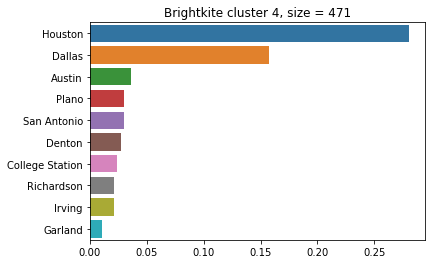

In [25]:
homes, counts = process_cluster(B_clust.subgraph(B_arg_sizes[3]), B_homes)
sns.barplot(counts[:10], counts.index[:10])
plt.title(f"Brightkite cluster 4, size = {homes.shape[0]}")
plt.xlabel("")
map_plot(homes, f"B{4}_us")

For the gowalla data set we see that the largest city is, by quite a large margin, Austin. This is a bit surprising since it is only the 11th largest city (as of today) in the US. It seems that this social network was particularily popular in Austin. This might be related to the fact that Austin is very underrepresented in the brightkite data set, with the Texan cluster being dominated by Houston and Dallas. Since the check-ins are from the same time period what we are seeing might be the two social networks competing for users, with users from each network being concentrated in different cities.

100%|██████████| 1585000/1585000 [05:07<00:00, 5162.25it/s]


Text(0.5, 1.0, 'Gowalla top 10 cities')

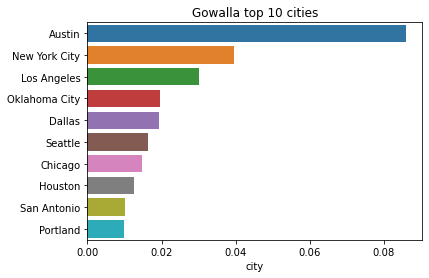

In [20]:
n_samples = 5000
sample_homes = G_homes.sample(n_samples)
G_counts = get_city_counts(sample_homes)
G_counts /= n_samples 
sns.barplot(G_counts[:10], G_counts.index[:10])
plt.title("Gowalla top 10 cities")

Just as with brightkite, the largest cluster is quite spread out.

100%|██████████| 1585000/1585000 [05:08<00:00, 5144.77it/s]


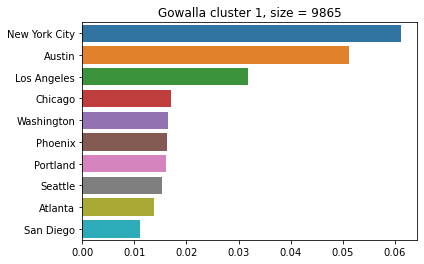

In [21]:
homes, counts = process_cluster(G_clust.subgraph(G_arg_sizes[0]), G_homes)
sns.barplot(counts[:10], counts.index[:10])
plt.title(f"Gowalla cluster {1}, size = {homes.shape[0]}")
plt.xlabel("")
map_plot(homes, f"G{1}_us")

The second cluster is also fairly spread out, but it is a bit more concentrated in Texas, with 3 of the top 4 cities being in Texas.

100%|██████████| 1585000/1585000 [05:12<00:00, 5069.69it/s]


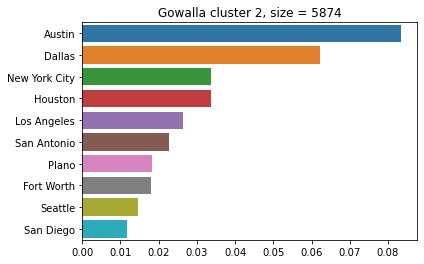

In [26]:
homes, counts = process_cluster(G_clust.subgraph(G_arg_sizes[1]), G_homes)
sns.barplot(counts[:10], counts.index[:10])
plt.title(f"Gowalla cluster {2}, size = {homes.shape[0]}")
plt.xlabel("")
map_plot(homes, f"G{2}_us")

The third cluster is dominated by Austin. Compared to the previous one, it is much more concentrated, with over 60% of users living in Austin.

100%|██████████| 692328/692328 [02:10<00:00, 5304.52it/s]


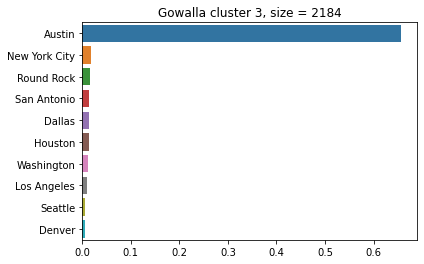

In [22]:
homes, counts = process_cluster(G_clust.subgraph(G_arg_sizes[2]), G_homes)
sns.barplot(counts[:10], counts.index[:10])
plt.title(f"Gowalla cluster {3}, size = {homes.shape[0]}")
plt.xlabel("")
map_plot(homes, f"G{3}_us")

The fourth cluster is similar to the second cluster in the brightkite data set. It is dominated by three large cities which are very far apart.

100%|██████████| 680599/680599 [02:14<00:00, 5062.91it/s]


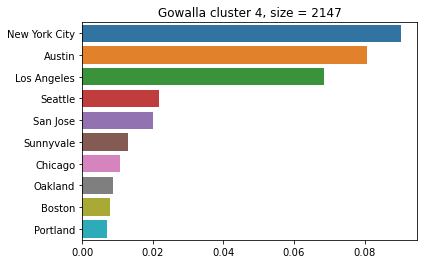

In [27]:
homes, counts = process_cluster(G_clust.subgraph(G_arg_sizes[3]), G_homes)
sns.barplot(counts[:10], counts.index[:10])
plt.title(f"Gowalla cluster {4}, size = {homes.shape[0]}")
plt.xlabel("")
map_plot(homes, f"G{4}_us")

## Research question 4

Load the countries data

In [610]:
%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/data"

countries = pd.read_pickle("countries.pkl")

countries

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/data


,name,alpha_2,alpha_3,languages,main_religion
0,Afghanistan,AF,AFG,Afghan,Islam
1,Albania,AL,ALB,Albanian,Islam
2,Algeria,DZ,DZA,Arabic,Islam
3,Andorra,AD,AND,Catalan,Roman Catholic
4,Angola,AO,AGO,Portuguese,Roman Catholic
...,...,...,...,...,...
192,"Korea, Democratic People's Republic of",KP,PRK,Korean,Buddhism
193,"Korea, Republic of",KR,KOR,Korean,Christianity
194,Lao People's Democratic Republic,LA,LAO,Lao,Buddhism
195,"Palestine, State of",PS,PSE,Palauan,Islam


Plot the languages spoken in each country

In [611]:
df = px.data.gapminder().query("year==2007")
fig = px.choropleth(countries, locations="alpha_3",
                    color="languages", # lifeExp is a column of gapminder
                    hover_name="name",
                    color_discrete_sequence=px.colors.qualitative.Antique,)

#fig.update_layout(plot_bgcolor='seashell')
fig.update_layout(geo=dict(bgcolor= 'seashell'))
fig.update_layout(
    title="Main languages spoken per country",
    legend_title="Languages"
    )
fig.show()

%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots"
html = plot(fig, auto_open=False, output_type='div')
with open("world_languages.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots


In [612]:
fig = px.choropleth(countries, locations="alpha_3",
                    color="main_religion", 
                    hover_name="name",
                    color_discrete_sequence=px.colors.qualitative.Antique,)


fig.update_layout(geo=dict(bgcolor= 'seashell'))
fig.update_layout(
    title="Main religion per country",
    legend_title="Religion"
    )
fig.show()

%cd "/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots"
html = plot(fig, auto_open=False, output_type='div')
with open("world_religions.html", 'w') as file:
    file.write(html)

/home/mogan/Desktop/z_ada/ada-2020-project-milestone-p3-p3_/plots
